In [165]:
import pandas as pd
from urllib.request import Request, urlretrieve
from pathlib import Path  
import ssl
import os
import re
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.metrics import accuracy_score
from matplotlib import pyplot as plt
from PIL import Image
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import Sequential, layers
from tensorflow.keras.layers.experimental.preprocessing import Rescaling
from tensorflow.keras import optimizers
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import classification_report
%load_ext autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load and download images (for the first time)

Start by defining some paths, then remove duplicates and N/A fields from the data.

In [3]:
BUCKET_NAME = 'art-api-sg'
#BUCKET_TRAIN_DATA_PATH = 'data/train_1k.csv'
BUCKET_TRAIN_DATA_PATH = 'yourpaintings'
PATH = Path("../raw_data")
PATH_YOURPAINTINGS = PATH/"yourpaintings"
MODEL_NAME = 'art-api'
MODEL_VERSION = 'baseline'

In [71]:
df_yourpaintings = pd.read_csv("https://www.robots.ox.ac.uk/~vgg/data/paintings/painting_dataset_2021.csv")
df_yourpaintings = df_yourpaintings.drop_duplicates()
df_yourpaintings = df_yourpaintings.dropna()
df_yourpaintings

,Image URL,Web page URL,Subset,Labels
0,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/and-the-co...,'test',' cow'
1,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/0-6-00-6-0...,'train',' train'
2,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/044t-locom...,'train',' train'
3,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/080-locomo...,'test',' train'
4,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/17th-and-2...,'test',' horse'
...,...,...,...,...
8623,https://d3d00swyhr67nd.cloudfront.net/w944h944...,https://artuk.org/discover/artworks/youth-82434,'test',' diningtable'
8625,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/yport-20094,'test',' boat'
8626,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/yport-norm...,'train',' bird'
8627,https://d3d00swyhr67nd.cloudfront.net/w944h944...,https://artuk.org/discover/artworks/zebra-and-...,'train',' bird'


In [82]:
# for every row, save images from working urls and drop rows with inaccessible images
for index, row in df_yourpaintings.iterrows():
    url = str(row["Image URL"])
    fname = url[url.rfind("/")+1:]
    try:
        save_file = os.path.join(PATH_YOURPAINTINGS, fname)
        urlretrieve(url, save_file)
        df_yourpaintings.at[index, "filename"] = fname
    except:
        df_yourpaintings.drop(index=index, axis=0, inplace=True)

In [102]:
df_yourpaintings = df_yourpaintings.reset_index()

# Encode class labels (object categories)

In [68]:
# extract labels into a new column called 'label_classes'
labels = []

for index, row in df_yourpaintings.iterrows():
    text = row["Labels"]
    labels.append(re.findall("[a-z]+", text, flags=re.IGNORECASE))

In [104]:
labels = pd.Series(labels)
df_yourpaintings["labels"] = labels

In [115]:
mlb = MultiLabelBinarizer()
df_yourpaintings = pd.concat([df_yourpaintings, pd.DataFrame(mlb.fit_transform(df_yourpaintings["labels"]), columns=mlb.classes_,)], axis=1)

# Save our dataframe

In [4]:
#save images that are successfuly downloaded into a clean csv
PATH_FILE = Path(PATH_YOURPAINTINGS/"df_yourpaintings.csv")  
PATH_FILE.parent.mkdir(parents=True, exist_ok=True)
df_yourpaintings.to_csv(PATH_FILE, index=False)

NameError: name 'df_yourpaintings' is not defined

In [6]:
df = pd.read_csv(PATH_FILE)
df

,index,Image URL,Web page URL,Subset,Labels,filename,labels,aeroplane,bird,boat,chair,cow,diningtable,dog,horse,sheep,train
0,0,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/and-the-co...,'test',' cow',NID_QUB_QUB_264-001.jpg,['cow'],0,0,0,0,1,0,0,0,0,0
1,1,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/0-6-00-6-0...,'train',' train',GMIII_MOSI_A1978_72_3-001.jpg,['train'],0,0,0,0,0,0,0,0,0,1
2,2,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/044t-locom...,'train',' train',NY_NRM_1979_7964-001.jpg,['train'],0,0,0,0,0,0,0,0,0,1
3,3,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/080-locomo...,'test',' train',CHE_CRHC_PCF40-001.jpg,['train'],0,0,0,0,0,0,0,0,0,1
4,4,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/17th-and-2...,'test',' horse',NOT_NTMAG_1997_31-001.jpg,['horse'],0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8291,8623,https://d3d00swyhr67nd.cloudfront.net/w944h944...,https://artuk.org/discover/artworks/youth-82434,'test',' diningtable',LLR_AWC_0047-001.jpg,['diningtable'],0,0,0,0,0,1,0,0,0,0
8292,8625,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/yport-20094,'test',' boat',STF_STKMG_1965_FA_10-001.jpg,['boat'],0,0,1,0,0,0,0,0,0,0
8293,8626,https://d3d00swyhr67nd.cloudfront.net/w1200h12...,https://artuk.org/discover/artworks/yport-norm...,'train',' bird',NY_YAG_YORAG_1030-001.jpg,['bird'],0,1,0,0,0,0,0,0,0,0
8294,8627,https://d3d00swyhr67nd.cloudfront.net/w944h944...,https://artuk.org/discover/artworks/zebra-and-...,'train',' bird',GL_GM_A_1989_23_e-001.jpg,['bird'],0,1,0,0,0,0,0,0,0,0


In [12]:
df.columns

Index(['index', 'Image URL', 'Web page URL', 'Subset', 'Labels', 'filename',
       'labels', 'aeroplane', 'bird', 'boat', 'chair', 'cow', 'diningtable',
       'dog', 'horse', 'sheep', 'train'],
      dtype='object')

# Prepare images for training

In [13]:
imgs = []

In [14]:
for index, row in df.iterrows():
    img_file = str(row["filename"])
    image = Image.open(os.path.join(PATH_YOURPAINTINGS, img_file))
    image = image.resize((256, 256))
    imgs.append(np.array(image))

In [15]:
X = np.array(imgs)
X.shape

(8296, 256, 256, 3)

In [16]:
y = df.drop(columns=['index', 'Image URL', 'Web page URL', 'Subset', 'Labels', 'filename',
       'labels'])
y.shape

(8296, 10)

In [17]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.3)

In [31]:
def load_baseline_model():

    model = Sequential()
    model.add(Rescaling(1./255, input_shape=(256,256,3)))

    model.add(layers.Conv2D(16, kernel_size=10, activation='relu'))
    model.add(layers.MaxPooling2D(3))
    
    model.add(layers.Conv2D(32, kernel_size=8, activation="relu"))
    model.add(layers.MaxPooling2D(3))

    model.add(layers.Conv2D(32, kernel_size=6, activation="relu"))
    model.add(layers.MaxPooling2D(3))
    
    model.add(layers.Flatten())
    model.add(layers.Dense(100, activation='relu'))
    model.add(layers.Dense(10, activation='sigmoid'))
    
    opt = optimizers.Adam(learning_rate=1e-4)
    model.compile(loss='binary_crossentropy',
                  optimizer=opt,
                  metrics=['accuracy'])
    
    return model

In [110]:
def load_softmax_model():

    model = Sequential()
    model.add(Rescaling(1./255, input_shape=(256,256,3)))

    model.add(layers.Conv2D(16, kernel_size=10, activation='relu'))
    model.add(layers.MaxPooling2D(3))
    
    model.add(layers.Conv2D(32, kernel_size=8, activation="relu"))
    model.add(layers.MaxPooling2D(3))

    model.add(layers.Conv2D(32, kernel_size=6, activation="relu"))
    model.add(layers.MaxPooling2D(3))
    
    model.add(layers.Flatten())
    model.add(layers.Dense(100, activation='relu'))
    model.add(layers.Dense(10, activation='softmax'))
    
    opt = optimizers.Adam(learning_rate=1e-4)
    model.compile(loss='binary_crossentropy',
                  optimizer=opt,
                  metrics=['accuracy'])
    
    return model

In [111]:
model = load_softmax_model()
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 256, 256, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 247, 247, 16)      4816      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 82, 82, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 75, 75, 32)        32800     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 25, 25, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 20, 20, 32)       

In [112]:
es = EarlyStopping(monitor = 'val_accuracy', 
                   mode = 'max', 
                   patience = 5, 
                   verbose = 1, 
                   restore_best_weights = True)

In [113]:
history = model.fit(X_train, y_train,
                    validation_data=[X_val, y_val],
                    batch_size = 32, 
                    epochs = 10, 
                    callbacks=[es],
                    verbose=1)

Epoch 1/10
182/182 [==============================] - 196s 1s/step - loss: 0.3708 - accuracy: 0.2487 - val_loss: 0.3290 - val_accuracy: 0.3052
Epoch 2/10
182/182 [==============================] - 194s 1s/step - loss: 0.3194 - accuracy: 0.3248 - val_loss: 0.3159 - val_accuracy: 0.3307
Epoch 3/10
182/182 [==============================] - 202s 1s/step - loss: 0.3097 - accuracy: 0.3336 - val_loss: 0.3075 - val_accuracy: 0.3440
Epoch 4/10
182/182 [==============================] - 196s 1s/step - loss: 0.3028 - accuracy: 0.3473 - val_loss: 0.3064 - val_accuracy: 0.3534
Epoch 5/10
182/182 [==============================] - 191s 1s/step - loss: 0.2973 - accuracy: 0.3713 - val_loss: 0.3027 - val_accuracy: 0.3320
Epoch 6/10
182/182 [==============================] - 189s 1s/step - loss: 0.2928 - accuracy: 0.3771 - val_loss: 0.2975 - val_accuracy: 0.3681
Epoch 7/10
182/182 [==============================] - 193s 1s/step - loss: 0.2890 - accuracy: 0.3797 - val_loss: 0.2968 - val_accuracy: 0.3735

In [9]:
model = keras.models.load_model(PATH_YOURPAINTINGS)

2022-09-05 23:07:20.029339: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:06:00.0/numa_node
Your kernel may have been built without NUMA support.
2022-09-05 23:07:20.091374: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudnn.so.8'; dlerror: libcudnn.so.8: cannot open shared object file: No such file or directory
2022-09-05 23:07:20.091389: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1850] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...
2022-09-05 23:07:20.092172: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (o

In [115]:
res = model.evaluate(X_test, y_test)
res

55/55 [==============================] - 7s 136ms/step - loss: 0.2936 - accuracy: 0.3921


[0.29361578822135925, 0.39207807183265686]

In [116]:
test_accuracy = res[-1]
print(f"test_accuracy = {round(test_accuracy,2)*100} %")

test_accuracy = 39.0 %


In [20]:
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

NameError: name 'history' is not defined

# Save model and look at some predictions

In [117]:
model.save(os.path.join(PATH_YOURPAINTINGS, "softmax"))
#(PATH_YOURPAINTINGS)

INFO:tensorflow:Assets written to: ../raw_data/yourpaintings/softmax/assets


INFO:tensorflow:Assets written to: ../raw_data/yourpaintings/softmax/assets


In [80]:
y_pred = model.predict(X_test)

55/55 [==============================] - 7s 123ms/step


In [87]:
labels_lst = ['aeroplane', 'bird', 'boat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'sheep', 'train']
proba = y_pred

In [120]:
predictions = (model.predict(X_test) > 0.5).astype("int32")

55/55 [==============================] - 301s 6s/step


In [134]:
predictions[7]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [135]:
predictions_cls = np.argmax(model.predict(X_test),axis=1)

55/55 [==============================] - 67s 561ms/step


In [137]:
print(classification_report(y_test, predictions, output_dict=False, target_names=labels_lst))

              precision    recall  f1-score   support

   aeroplane       0.00      0.00      0.00        39
        bird       1.00      0.01      0.01       163
        boat       0.60      0.58      0.59       448
       chair       0.61      0.37      0.46       235
         cow       0.00      0.00      0.00       130
 diningtable       0.50      0.04      0.07       252
         dog       0.00      0.00      0.00       225
       horse       0.47      0.17      0.25       296
       sheep       1.00      0.01      0.01       160
       train       0.86      0.34      0.49        74

   micro avg       0.59      0.21      0.31      2022
   macro avg       0.50      0.15      0.19      2022
weighted avg       0.53      0.21      0.25      2022
 samples avg       0.25      0.23      0.24      2022



/home/erniesg/.pyenv/versions/3.8.12/envs/lewagon/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/erniesg/.pyenv/versions/3.8.12/envs/lewagon/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [138]:
# Load the sigmoid model
model = keras.models.load_model(PATH_YOURPAINTINGS)

In [198]:
sig_predictions = (model.predict(X_test) > 0.5).astype("int32")

55/55 [==============================] - 7s 126ms/step


In [199]:
print(classification_report(y_test, sig_predictions, output_dict=False, target_names=labels_lst))

              precision    recall  f1-score   support

   aeroplane       0.00      0.00      0.00        39
        bird       1.00      0.01      0.01       163
        boat       0.76      0.33      0.47       448
       chair       0.67      0.34      0.45       235
         cow       0.00      0.00      0.00       130
 diningtable       0.58      0.06      0.11       252
         dog       0.57      0.02      0.03       225
       horse       1.00      0.02      0.03       296
       sheep       0.75      0.02      0.04       160
       train       0.76      0.42      0.54        74

   micro avg       0.72      0.14      0.24      2022
   macro avg       0.61      0.12      0.17      2022
weighted avg       0.70      0.14      0.20      2022
 samples avg       0.16      0.15      0.15      2022



/home/erniesg/.pyenv/versions/3.8.12/envs/lewagon/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/erniesg/.pyenv/versions/3.8.12/envs/lewagon/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [218]:
sig_predictions_df.sum()

aeroplane        0
bird             1
boat           197
chair          120
cow              0
diningtable     26
dog              7
horse            5
sheep            4
train           41
dtype: int64

In [ ]:
print(f"a 0.5 threshold gives us positive labels for {401/1742} of paintings")

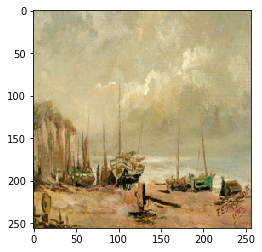

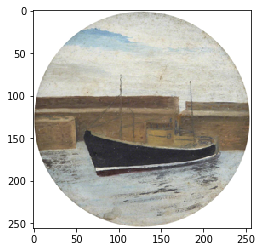

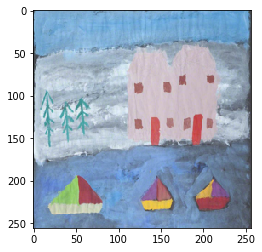

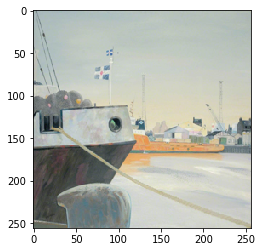

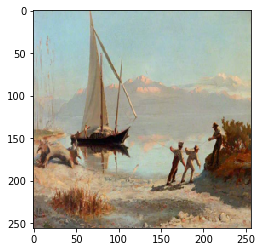

...

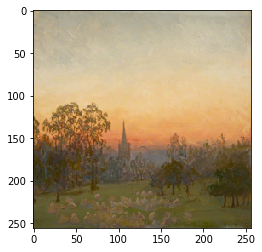

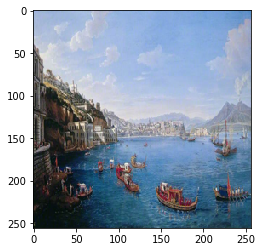

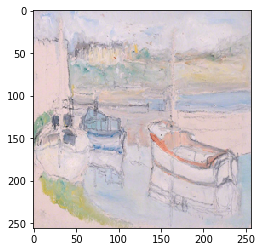

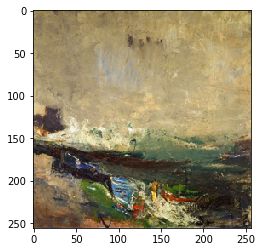

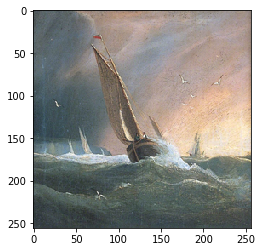

In [280]:
for i in boats_lst:
    plt.imshow(X_test[i], interpolation="nearest")
    plt.show()

In [281]:
chair_lst = sig_predictions_df.index[sig_predictions_df['chair'] == 1].tolist()

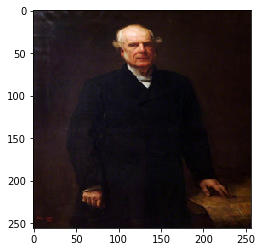

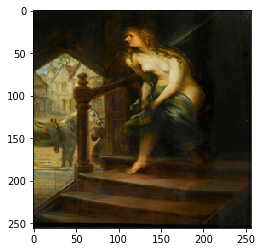

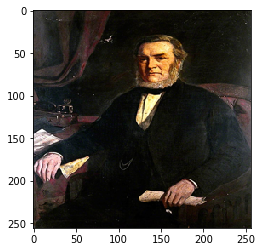

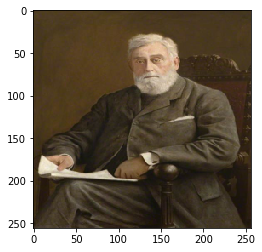

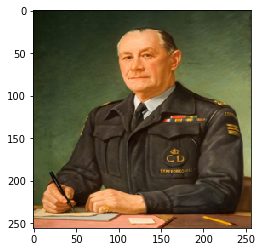

...

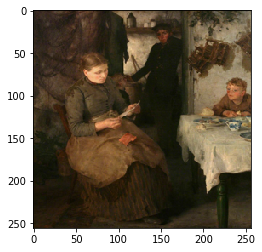

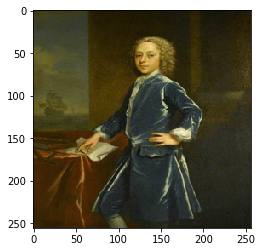

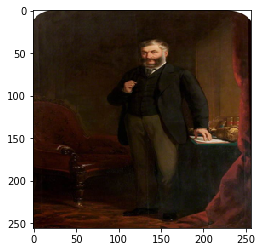

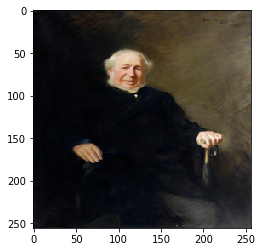

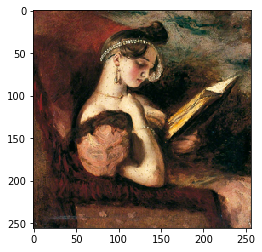

In [282]:
for i in chair_lst:
    plt.imshow(X_test[i], interpolation="nearest")
    plt.show()

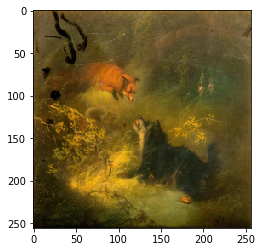

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


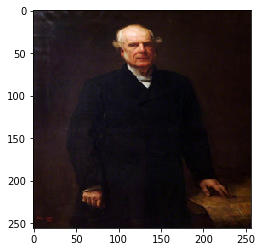

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 1, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


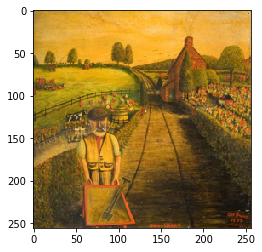

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


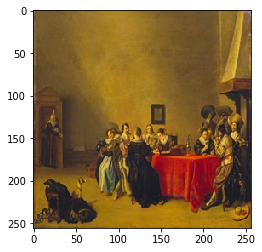

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


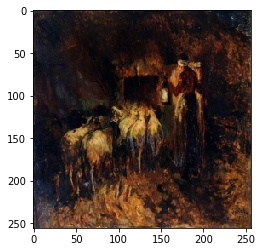

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


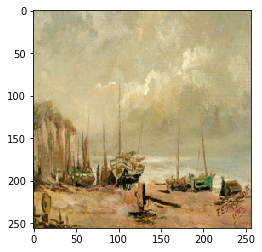

{'aeroplane': 0, 'bird': 0, 'boat': 1, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


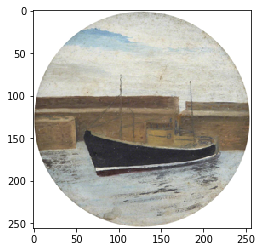

{'aeroplane': 0, 'bird': 0, 'boat': 1, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


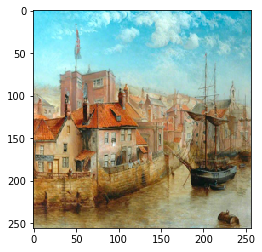

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


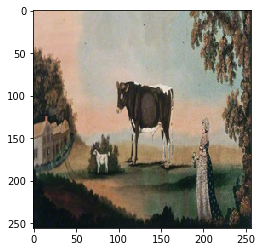

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


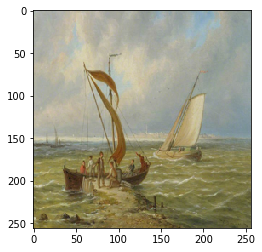

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


In [256]:
for i in range(len(X_test)):
    if i < 10:
        plt.imshow(X_test[i], interpolation="nearest")
        plt.show()
        pred_dict = dict(zip(labels_lst, sig_predictions[i]))
        print(pred_dict)

In [200]:
sig_predictions_df = pd.DataFrame(sig_predictions)

In [268]:
boats_lst = sig_predictions_df.index[sig_predictions_df['boat'] == 1].tolist()

ValueError: num must be 1 <= num <= 20, not 38

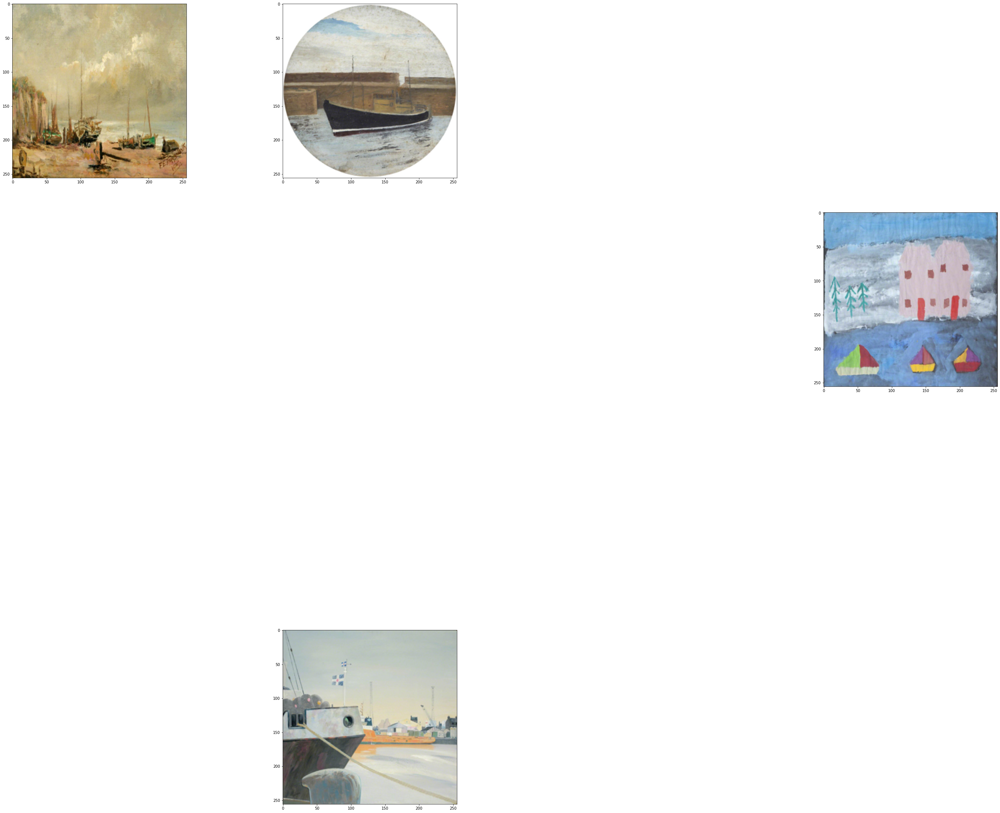

In [265]:
boats = sig_predictions_df.loc[sig_predictions_df['boat'] == 1]
boats

,aeroplane,bird,boat,chair,cow,diningtable,dog,horse,sheep,train
5,0,0,1,0,0,0,0,0,0,0
6,0,0,1,0,0,0,0,0,0,0
12,0,0,1,0,0,0,0,0,0,0
18,0,0,1,0,0,0,0,0,0,0
38,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...
1706,0,0,1,0,0,0,0,0,0,0
1707,0,0,1,0,0,0,0,0,0,0
1710,0,0,1,0,0,0,0,0,0,0
1722,0,0,1,0,0,0,0,0,0,0


In [266]:
for index, row in boats.iterrows():
    i = boats.Rows.IndexOf(row)

AttributeError: 'DataFrame' object has no attribute 'Rows'

In [264]:
for index in boats:
    print(index)

aeroplane
bird
boat
chair
cow
diningtable
dog
horse
sheep
train


In [222]:
print(f"a 0.5 threshold gives us positive labels for {401/1742} of paintings")

a 0.5 threshold gives us positive labels for 0.23019517795637198 of paintings


In [223]:
sig_predictions_2 = (model.predict(X_test) > 0.25).astype("int32")

55/55 [==============================] - 7s 125ms/step


In [224]:
print(classification_report(y_test, sig_predictions_2, output_dict=False, target_names=labels_lst))

              precision    recall  f1-score   support

   aeroplane       0.31      0.13      0.18        39
        bird       0.25      0.10      0.15       163
        boat       0.55      0.74      0.63       448
       chair       0.46      0.60      0.52       235
         cow       0.31      0.06      0.10       130
 diningtable       0.34      0.54      0.42       252
         dog       0.28      0.24      0.26       225
       horse       0.45      0.31      0.37       296
       sheep       0.39      0.13      0.20       160
       train       0.36      0.62      0.46        74

   micro avg       0.43      0.42      0.42      2022
   macro avg       0.37      0.35      0.33      2022
weighted avg       0.40      0.42      0.39      2022
 samples avg       0.37      0.43      0.38      2022



/home/erniesg/.pyenv/versions/3.8.12/envs/lewagon/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [225]:
sig_predictions_2_df = pd.DataFrame(sig_predictions_2)
sig_predictions_2_df.sum()
#print(f"a 0.25 threshold gives us positive labels for {401/1742} of paintings")

0     16
1     68
2    599
3    309
4     26
5    399
6    199
7    206
8     54
9    127
dtype: int64

In [205]:
sig_predictions_df.columns = ['aeroplane', 'bird', 'boat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'sheep', 'train']

In [215]:
sig_predictions_df.loc[sig_predictions_df['train'] == 1]

,aeroplane,bird,boat,chair,cow,diningtable,dog,horse,sheep,train
76,0,0,0,0,0,0,0,0,0,1
136,0,0,0,0,0,0,0,0,0,1
170,0,0,0,0,0,0,0,0,0,1
172,0,0,0,0,0,0,0,0,0,1
211,0,0,0,0,0,0,0,0,0,1
232,0,0,0,0,0,0,0,0,0,1
244,0,0,0,0,0,0,0,0,0,1
290,0,0,0,0,0,0,0,0,0,1
304,0,0,0,0,0,0,0,0,0,1
359,0,0,0,0,0,0,0,0,0,1


In [196]:
sig_predictions_df[sig_predictions_df['aeroplane'] == 1]

,aeroplane,bird,boat,chair,cow,diningtable,dog,horse,sheep,train


In [186]:
print(X_test.shape)
print(sig_predictions.shape)

(1742, 256, 256, 3)
(1742, 10)


In [173]:
sig_predictions_df = pd.DataFrame(sig_predictions)

(1742, 10)

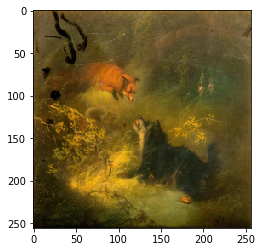

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


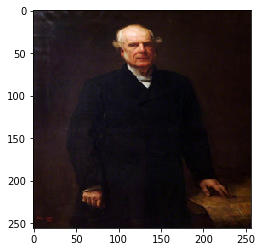

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 1, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


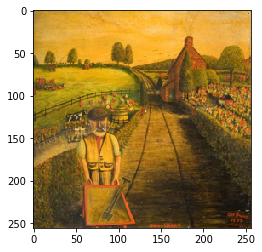

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


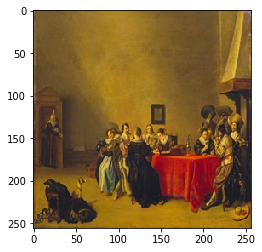

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


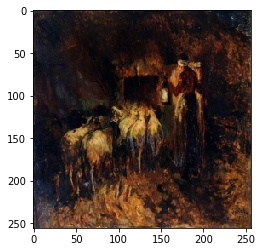

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


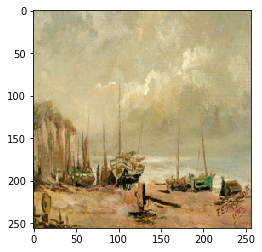

{'aeroplane': 0, 'bird': 0, 'boat': 1, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


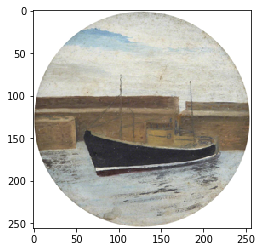

{'aeroplane': 0, 'bird': 0, 'boat': 1, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


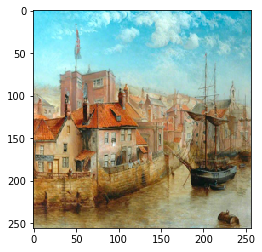

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


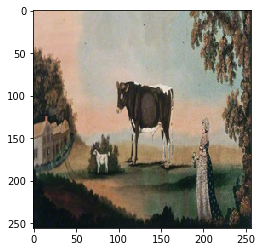

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


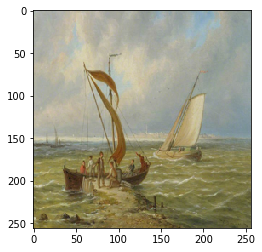

{'aeroplane': 0, 'bird': 0, 'boat': 0, 'chair': 0, 'cow': 0, 'diningtable': 0, 'dog': 0, 'horse': 0, 'sheep': 0, 'train': 0}


In [179]:
sig_predictions[0]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [176]:
class_table = pd.concat([pd.DataFrame(X_test), pd.DataFrame(sig_predictions)], axis=1)

ValueError: Must pass 2-d input. shape=(1742, 256, 256, 3)

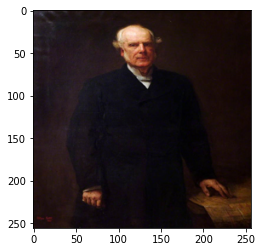

In [178]:
plt.imshow(X_test[1])

In [ ]:
for i in range(len(X_test)):
    if i < 10:
        top_3 = np.argsort(proba[i])[:-4:-1]
        plt.imshow(X_test[i], interpolation="nearest")
        plt.show()
        pred_dict = dict(zip(labels_lst, y_pred[i]))
        print(pred_dict)
        print(f"the top 3 classes are: {labels_lst[top_3[0]]}, {labels_lst[top_3[1]]} and {labels_lst[top_3[2]]}")

In [175]:
print(type(X_test))
print(type(sig_predictions))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [157]:
y_test_arr = np.array(y_test)
print(type(y_test_arr))
print(y_test_arr.shape)

sig_predictions_df = pd.DataFrame(sig_predictions)

<class 'numpy.ndarray'>
(1742, 10)


In [168]:
import tensorflow_addons as tfa
from tfa.metrics import MultiLabelConfusionMatrix

ModuleNotFoundError: No module named 'tensorflow_addons'

In [158]:
multilabel_confusion_matrix(y_test, sig_predictions_df, labels=labels_lst)

/home/erniesg/.pyenv/versions/3.8.12/envs/lewagon/lib/python3.8/site-packages/numpy/lib/arraysetops.py:608: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask &= (ar1 != a)


UFuncTypeError: ufunc 'maximum' did not contain a loop with signature matching types (dtype('<U21'), dtype('<U21')) -> None

In [144]:
test_accuracy = model.evaluate(X_test, y_test)
test_accuracy = res[-1]
print(f"test_accuracy = {round(test_accuracy,2)*100} %")

55/55 [==============================] - 7s 130ms/step - loss: 0.2851 - accuracy: 0.3972
test_accuracy = 39.0 %


In [151]:
print(type(sig_predictions.shape))
print(type(X_test.shape))

<class 'tuple'>
<class 'tuple'>


In [143]:
acc = accuracy_score(y_test, sig_predictions)
# store result
print('>%.3f' % acc)

>0.139


In [136]:
predictions_cls.shape

(1742,)

In [88]:
#y_test_arr = np.transpose(y_test)
#y_pred_arr = np.transpose(y_pred)
y_test_arr = np.array(y_test)
y_pred_arr = np.array(y_pred)

In [97]:
print(y_test.shape)
print(y_pred_test.shape)
print(type(y_pred_test))

(1742, 10)
(1742,)
<class 'numpy.ndarray'>


In [94]:
mlb = MultiLabelBinarizer()
mlb.fit(df["labels"])
y_pred_arr = mlb.transform(y_pred_test)
#y_pred_arr = pd.concat([df_yourpaintings, pd.DataFrame(mlb.fit_transform(df_yourpaintings["labels"]), columns=mlb.classes_,)], axis=1)
#multilabel_binarizer.transform(y_pred)

TypeError: 'numpy.int64' object is not iterable

In [ ]:
y_test_arr = mlb.fit_transform(df["labels"])

In [93]:
from sklearn.metrics import multilabel_confusion_matrix
multilabel_confusion_matrix(y_test, y_pred_arr, labels=labels_lst)

ValueError: Classification metrics can't handle a mix of multilabel-indicator and continuous-multioutput targets

In [74]:
y_pred_arr.shape

(8296, 21)

In [26]:
y_test_arg=np.argmax(y_test,axis=1)
Y_pred = np.argmax(model.predict(X_test),axis=1)
print('Confusion Matrix')
print(confusion_matrix(y_test_arg, Y_pred))

# y_pred=model.predict(X_test) 
# y_pred=np.argmax(y_pred, axis=1)
# y_test=np.argmax(y_test, axis=1)
# cm = confusion_matrix(y_test, y_pred)
# print(cm)

# from sklearn.metrics import multilabel_confusion_matrix
# multilabel_confusion_matrix(y_test, y_pred, labels=labels_lst)

ValueError: Shape of passed values is (1742, 1), indices imply (1742, 10)

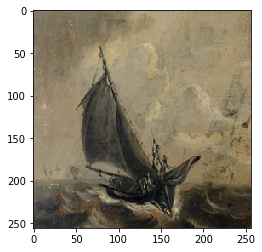

{'aeroplane': 0.011510649, 'bird': 0.058980286, 'boat': 0.4657647, 'chair': 0.107780285, 'cow': 0.05964142, 'diningtable': 0.13066083, 'dog': 0.07446681, 'horse': 0.0835417, 'sheep': 0.027961489, 'train': 0.0679767}
the top 3 classes are: boat, diningtable and chair


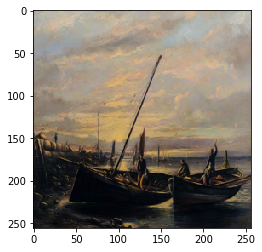

{'aeroplane': 0.0069908835, 'bird': 0.073846504, 'boat': 0.7109203, 'chair': 0.052852217, 'cow': 0.06628267, 'diningtable': 0.027389439, 'dog': 0.068699524, 'horse': 0.06838873, 'sheep': 0.055856816, 'train': 0.021909487}
the top 3 classes are: boat, bird and dog


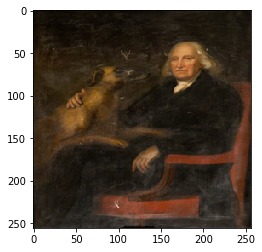

{'aeroplane': 0.0029774709, 'bird': 0.13786562, 'boat': 0.0416988, 'chair': 0.732465, 'cow': 0.020253956, 'diningtable': 0.43880045, 'dog': 0.15119307, 'horse': 0.086714655, 'sheep': 0.028905299, 'train': 0.010970064}
the top 3 classes are: chair, diningtable and dog


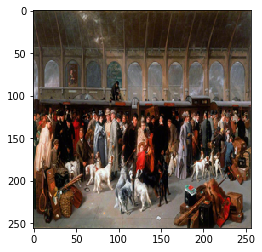

{'aeroplane': 0.00047224207, 'bird': 0.19782655, 'boat': 0.05197912, 'chair': 0.25675035, 'cow': 0.0047155037, 'diningtable': 0.38016063, 'dog': 0.21556155, 'horse': 0.040112652, 'sheep': 0.0067676483, 'train': 0.18043947}
the top 3 classes are: diningtable, chair and dog


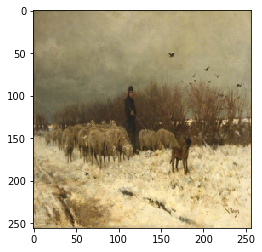

{'aeroplane': 0.013747182, 'bird': 0.08043737, 'boat': 0.33191603, 'chair': 0.029723644, 'cow': 0.09929886, 'diningtable': 0.057096746, 'dog': 0.16526976, 'horse': 0.1510413, 'sheep': 0.06962299, 'train': 0.01585079}
the top 3 classes are: boat, dog and horse


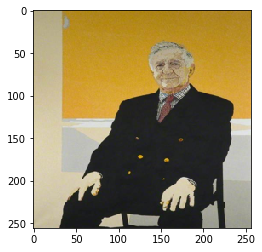

{'aeroplane': 0.00696808, 'bird': 0.030701378, 'boat': 0.25352976, 'chair': 0.22637038, 'cow': 0.002274111, 'diningtable': 0.2212968, 'dog': 0.066337705, 'horse': 0.029711854, 'sheep': 0.007477059, 'train': 0.016330788}
the top 3 classes are: boat, chair and diningtable


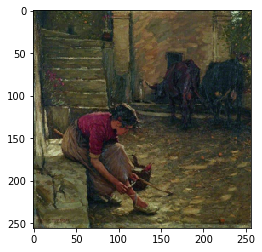

{'aeroplane': 0.014491059, 'bird': 0.25544348, 'boat': 0.11032209, 'chair': 0.24605648, 'cow': 0.075736314, 'diningtable': 0.29747686, 'dog': 0.23127078, 'horse': 0.1251727, 'sheep': 0.07669094, 'train': 0.120897636}
the top 3 classes are: diningtable, bird and chair


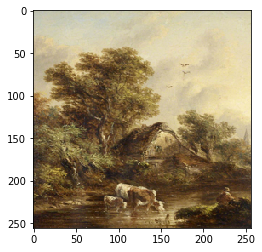

{'aeroplane': 0.0015015261, 'bird': 0.017672215, 'boat': 0.22402391, 'chair': 0.031162668, 'cow': 0.13949892, 'diningtable': 0.021721153, 'dog': 0.12647809, 'horse': 0.30596307, 'sheep': 0.11625271, 'train': 0.016982079}
the top 3 classes are: horse, boat and cow


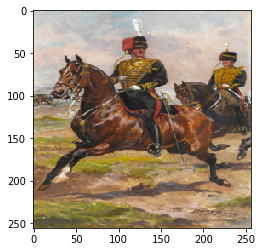

{'aeroplane': 0.002885907, 'bird': 0.06951065, 'boat': 0.05603365, 'chair': 0.046981283, 'cow': 0.033574387, 'diningtable': 0.05298028, 'dog': 0.1545101, 'horse': 0.28438777, 'sheep': 0.060476657, 'train': 0.036165845}
the top 3 classes are: horse, dog and bird


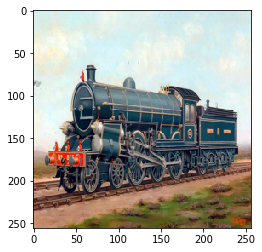

{'aeroplane': 0.010710217, 'bird': 0.021307072, 'boat': 0.104646064, 'chair': 0.024634711, 'cow': 0.006254345, 'diningtable': 0.010050898, 'dog': 0.0665563, 'horse': 0.07958088, 'sheep': 0.0069674, 'train': 0.96350926}
the top 3 classes are: train, boat and horse


In [99]:
for i in range(len(X_test)):
    if i < 10:
        top_3 = np.argsort(proba[i])[:-4:-1]
        plt.imshow(X_test[i], interpolation="nearest")
        plt.show()
        pred_dict = dict(zip(labels_lst, y_pred[i]))
        print(pred_dict)
        print(f"the top 3 classes are: {labels_lst[top_3[0]]}, {labels_lst[top_3[1]]} and {labels_lst[top_3[2]]}")

In [51]:
yhat = y_pred
yhat = yhat.round()
# calculate accuracy
acc = accuracy_score(y_test, yhat)
# store result
print('>%.3f' % acc)

>0.135
